<a href="https://colab.research.google.com/github/NazarYosa/sementara/blob/main/MCN_Learning_Classification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Classification CNN Python**

Kelompok - Machine Learning

(21102061) Sulthan Salman Altidar\
(21102071) Saeid Faqih Khoirullah\
(21102196) Yurico Sugandi


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

import matplotlib.pyplot as plt
import numpy as np
import os
import PIL
import tensorflow as tf

from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential
from sklearn.metrics import confusion_matrix

Mounted at /content/drive


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


Dataset

In [ ]:
import pathlib
dataset_url='/content/drive/MyDrive/Colab Notebooks/MCNLearning/Dataset'
data_dir = pathlib.Path(dataset_url)

In [ ]:
image_count = len(list(data_dir.glob('*/*.jpg'))) + len(list(data_dir.glob('*/*.JPG')))
print(image_count)

120


Tampil

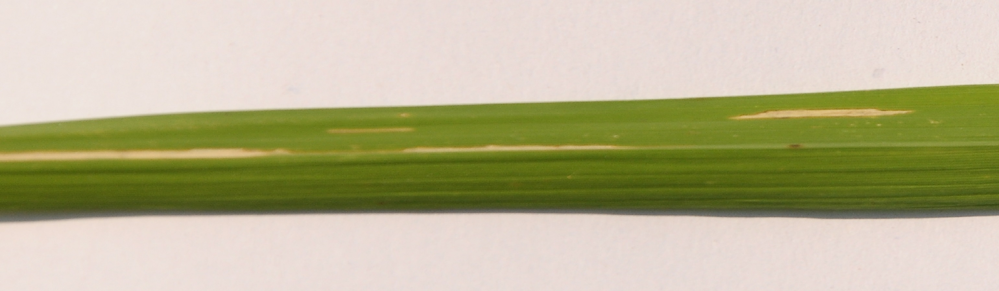

In [ ]:
BLB = list(data_dir.glob('Bacterial leaf blight/*'))
PIL.Image.open(str(BLB[0]))

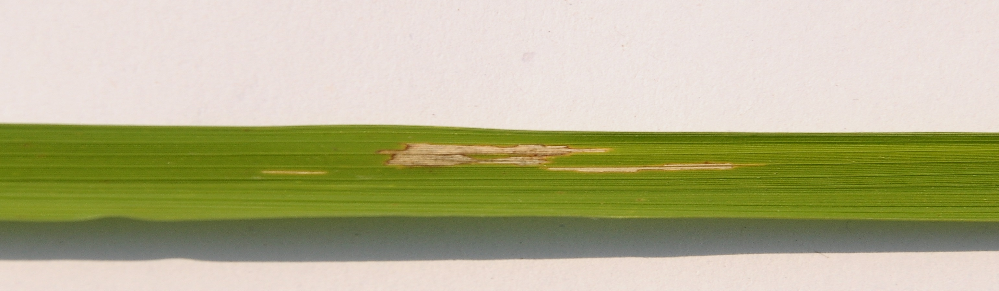

In [ ]:
PIL.Image.open(str(BLB[1]))

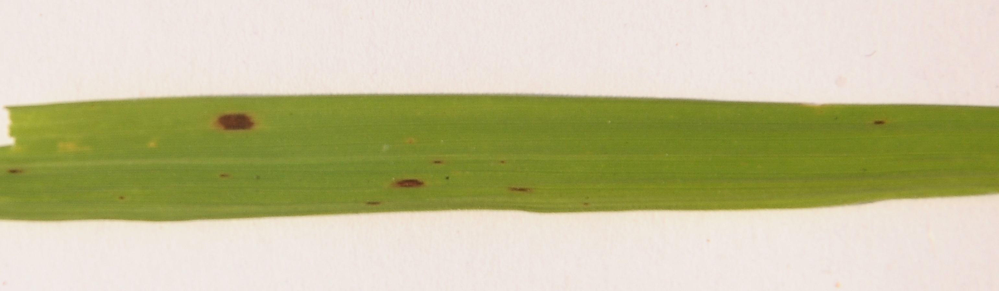

In [ ]:
BS = list(data_dir.glob('Brown spot/*'))
PIL.Image.open(str(BS[0]))

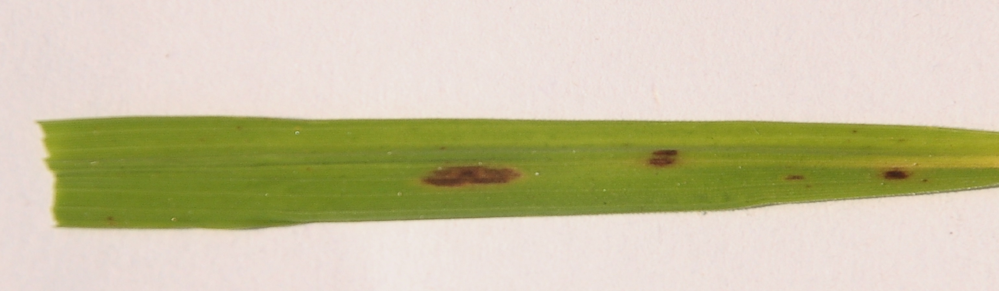

In [ ]:
PIL.Image.open(str(BS[1]))

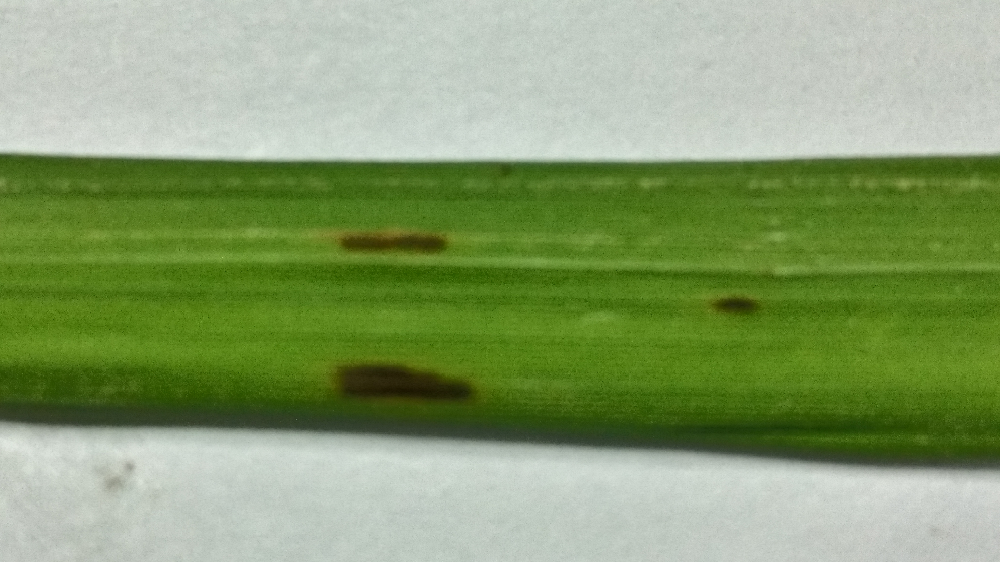

In [ ]:
LS = list(data_dir.glob('Leaf smut/*'))
PIL.Image.open(str(LS[0]))

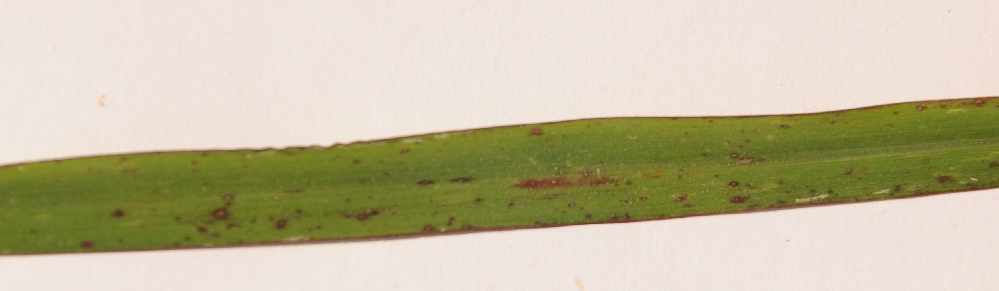

In [ ]:
PIL.Image.open(str(LS[1]))

In [ ]:
# create dataset
batch_size = 32
img_height = 180
img_width = 180

In [ ]:
# split dataset
train_ds = tf.keras.utils.image_dataset_from_directory(
    data_dir,
    validation_split=0.2,
    subset="training",
    seed=123,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 120 files belonging to 3 classes.
Using 96 files for training.


In [ ]:
val_ds = tf.keras.utils.image_dataset_from_directory (
    data_dir,
    validation_split=0.2,
    subset="validation",
    seed=123,
    image_size=(img_height, img_width),
    batch_size=batch_size)

Found 120 files belonging to 3 classes.
Using 24 files for validation.


In [ ]:
class_names = train_ds.class_names
print(class_names)

['Bacterial leaf blight', 'Brown spot', 'Leaf smut']


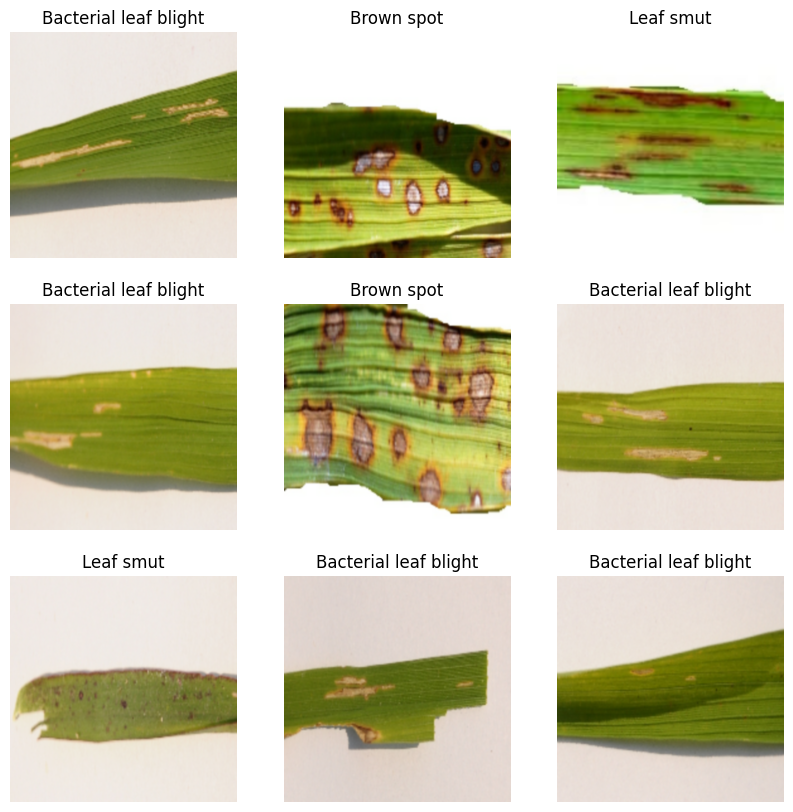

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 10))
for images, labels in train_ds.take(1):
    for i in range(9):
        ax = plt.subplot(3, 3, i + 1)
        # Menampilkan gambar dengan interpolasi bicubic
        plt.imshow(images[i].numpy().astype("uint8"), interpolation='bicubic', extent=[0, 2400, 0, 2400])
        plt.title(class_names[labels[i]])
        plt.axis("off")
plt.show()


In [ ]:
# melatih model menggunakan kumpulan data dan meneruskan ke model.fit
for image_batch, labels_batch in train_ds:
  print(image_batch.shape)
  print(labels_batch.shape)

  break

(32, 180, 180, 3)
(32,)


In [ ]:
AUTOTUNE = tf.data.AUTOTUNE

train_ds = train_ds.cache().shuffle (1000).prefetch(buffer_size=AUTOTUNE)
val_ds = val_ds.cache().prefetch (buffer_size=AUTOTUNE)

In [ ]:
normalization_layer = layers.Rescaling(1./255)

normalized_ds = train_ds.map(lambda x, y: (normalization_layer(x), y))
image_batch, labels_batch = next (iter (normalized_ds))
first_image = image_batch[0]

# Notice the pixel values are now in `[0,1]`.
print(np.min(first_image), np.max(first_image))

0.0 0.9558622


In [ ]:
num_classes = len(class_names)

model = Sequential([
    layers. Rescaling (1./255, input_shape=(img_height, img_width, 3)),
    layers.Conv2D (16, 3, padding='same', activation='relu'),
    layers.MaxPooling2D(),
    layers.Conv2D (32, 3, padding='same', activation='relu'),
    layers.MaxPooling2D(),
    layers.Conv2D (64, 3, padding='same', activation='relu'),
    layers.MaxPooling2D(),
    layers.Flatten(),
    layers. Dense (128, activation='relu'),
    layers. Dense(num_classes)
  ])

/usr/local/lib/python3.10/dist-packages/keras/src/layers/preprocessing/tf_data_layer.py:19: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(**kwargs)


In [ ]:
# compile
model.compile(optimizer='adam',
              loss=tf.keras.losses.SparseCategoricalCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [ ]:
model.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ rescaling_1 (Rescaling)              │ (None, 180, 180, 3)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 180, 180, 16)        │             448 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d (MaxPooling2D)         │ (None, 90, 90, 16)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 90, 90, 32)          │           4,640 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_1 (MaxPooling2D)       │ (None, 45, 45, 32)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_2 (Conv2D)                    │ (None, 45, 45, 64)          │          18,496 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ max_pooling2d_2 (MaxPooling2D)       │ (None, 22, 22, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 30976)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense (Dense)                        │ (None, 128)                 │       3,965,056 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 3)                   │             387 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 3,989,027 (15.22 MB)

 Trainable params: 3,989,027 (15.22 MB)

 Non-trainable params: 0 (0.00 B)

In [ ]:
epochs=60
history = model.fit(
    train_ds,
    validation_data=val_ds,
    epochs=epochs
)

Epoch 1/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 48s 22s/step - accuracy: 0.3359 - loss: 1.5806 - val_accuracy: 0.2917 - val_loss: 1.0990
Epoch 2/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 39s 1s/step - accuracy: 0.3516 - loss: 1.2144 - val_accuracy: 0.3333 - val_loss: 1.1367
Epoch 3/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.5625 - loss: 1.0322 - val_accuracy: 0.2917 - val_loss: 1.1340
Epoch 4/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 959ms/step - accuracy: 0.5664 - loss: 0.9523 - val_accuracy: 0.3750 - val_loss: 0.9822
Epoch 5/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 8s 2s/step - accuracy: 0.5768 - loss: 0.8510 - val_accuracy: 0.3750 - val_loss: 1.1155
Epoch 6/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.7409 - loss: 0.6820 - val_accuracy: 0.6250 - val_loss: 0.7334
Epoch 7/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 3s 1s/step - accuracy: 0.6693 - loss: 0.7160 - val_accuracy: 0.4167 - val_loss: 1.4124
Epoch 8/60
3/3 ━━━━━━━━━━━━━━━━━━━━ 6s 1s/step - accuracy: 0.6263 - loss: 0.6913 - val_accuracy: 0.7500 - val_loss: 0.6105
Epoch 9/60

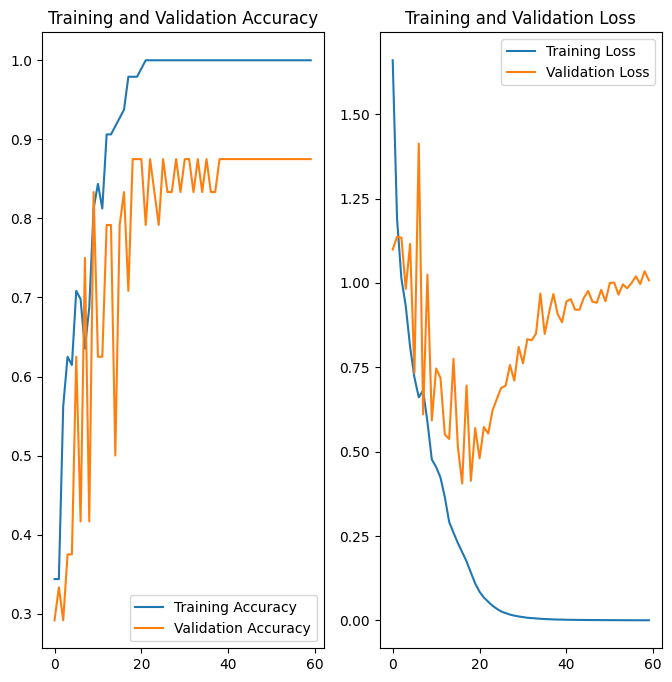

In [ ]:
# visualisasi training
acc = history.history['accuracy']
val_acc = history.history['val_accuracy']

loss = history.history['loss']
val_loss = history.history['val_loss']

epochs_range = range (epochs)
plt.figure(figsize=(8, 8))
plt.subplot(1, 2, 1)
plt.plot(epochs_range, acc, label='Training Accuracy')
plt.plot(epochs_range, val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.title('Training and Validation Accuracy')

plt.subplot(1, 2, 2)
plt.plot(epochs_range, loss, label='Training Loss')
plt.plot(epochs_range, val_loss, label='Validation Loss') # perubahan
plt.legend(loc='upper right')
plt.title('Training and Validation Loss')

plt.show()

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 254ms/step


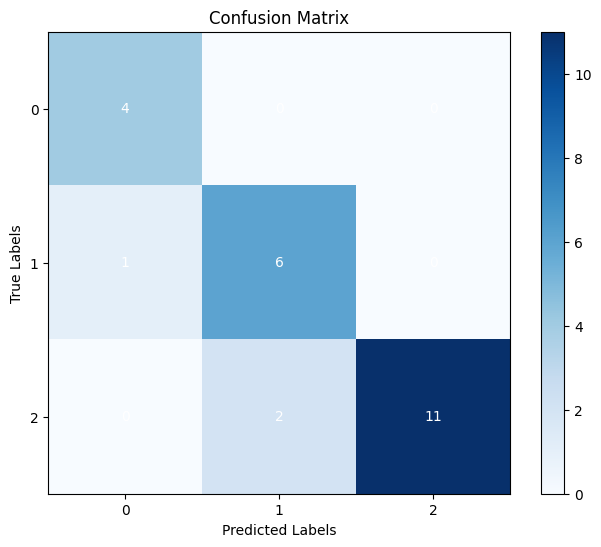

Accuracy: 0.875


In [ ]:
#Prediksi model pada data validasi
from sklearn.metrics import confusion_matrix
predictions = np.argmax(model.predict(val_ds), axis=-1)

true_labels = []
for _, labels in val_ds:
  true_labels.extend(labels.numpy())
true_labels = np.array(true_labels)

# Menampilkan nilai akurasi menggunakan confusion matrix

conf_matrix = confusion_matrix(true_labels, predictions)

plt.figure(figsize=(8, 6))
plt.imshow(conf_matrix, cmap='Blues')
plt.title('Confusion Matrix')
plt.colorbar()
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.xticks(np.arange(num_classes))
plt.yticks(np.arange(num_classes))
for i in range(num_classes):
    for j in range(num_classes):
        plt.text(j, i, conf_matrix[i, j], ha='center', va='center', color='white')
plt.show()

accuracy = np.sum(np.diag(conf_matrix)) / np.sum(conf_matrix)
print(f'Accuracy: {accuracy}')

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 284ms/step
Accuracy: 87.50%
Confusion Matrix:
[[ 4  0  0]
 [ 1  6  0]
 [ 0  2 11]]


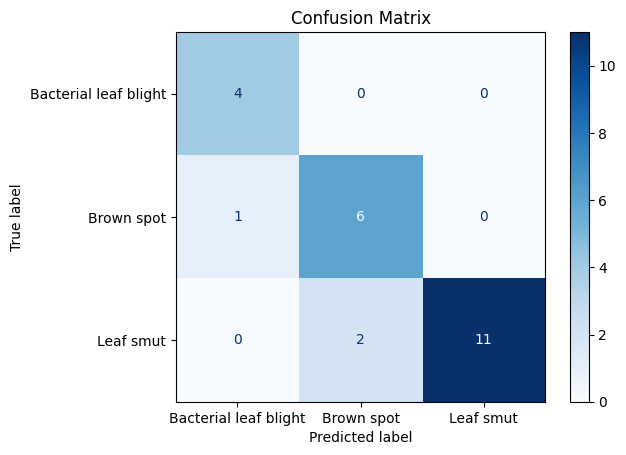

In [ ]:
from sklearn.metrics import confusion_matrix, accuracy_score, ConfusionMatrixDisplay
import seaborn as sns

val_ds = val_ds.unbatch()
val_images = []
val_labels = []
for images, labels in val_ds:
    val_images.append(images.numpy())
    val_labels.append(labels.numpy())

val_images = np.array(val_images)
val_labels = np.array(val_labels)

predictions = model.predict(val_images)
predictions = np.argmax(predictions, axis=1)

cm = confusion_matrix(val_labels, predictions)
accuracy = accuracy_score(val_labels, predictions)

print(f'Accuracy: {accuracy * 100:.2f}%')
print('Confusion Matrix:')
print(cm)

# Plot Confusion Matrix
cm_display = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=class_names)
cm_display.plot(cmap='Blues')
plt.title('Confusion Matrix')
plt.show()

In [ ]:
#Data testing

sunflower_path = '/content/drive/MyDrive/Colab Notebooks/MCNLearning/Test/blb1.jpg'
img = tf.keras.utils.load_img(
  sunflower_path, target_size=(img_height, img_width)
)
img_array = tf.keras.utils.img_to_array(img)
img_array = tf.expand_dims (img_array, 0) # Create a batch
predictions = model.predict(img_array)
score = tf.nn.softmax(predictions[0])
print(
  "This image most likely belongs to {} with a {:.2f} percent confidence." .format(class_names[np.argmax(score)], 100 * np.max(score))
)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
This image most likely belongs to Bacterial leaf blight with a 99.97 percent confidence.
